# Instrucciones:

El notebook se puede ejecutar linealmente, sin embargo el procesamiento en la parte de descarga de imagenes y extracción de caracteristicas es algo pesado, se hace esta primera iteración con subset de 2000 registros.

Tambien dejamos un dos archivos en la ruta

1.   train.csv - El dataset que se debe descargar en el primer bloque de código esto se hace por medio del id del archivo en drive.
2.   images_descriptors.csv - El segundo archivo se puede cargar desde la sección de modelo, este archivo ya contiene las caracteristicas extraidas, para probar en un modelo.





Importe de librerías

In [ ]:
from pydrive.auth import GoogleAuth
from pydrive.drive import GoogleDrive
from google.colab import auth
from oauth2client.client import GoogleCredentials

import numpy as np
import pandas as pd 

import cv2 as cv2 
from google.colab.patches import cv2_imshow # for image display
from skimage import io
from PIL import Image 
import matplotlib.pylab as plt
import os

import scipy
import scipy.spatial
import _pickle as pickle

Se instala esta versión especifico de opencv para la extracción de caracteristcas ya que con otras versiones presentabamos problemas

In [ ]:
!pip install opencv-contrib-python==4.4.0.44

# Lectura de archivo

Descarga del archivo con el dataset original de la competencia (https://www.kaggle.com/c/landmark-retrieval-challenge/data


In [ ]:
!gdown --id 1QtE_1jc_vtePpFR5VxQ5dgkofHeg2RiE

Downloading...
From: https://drive.google.com/uc?id=1QtE_1jc_vtePpFR5VxQ5dgkofHeg2RiE
To: /content/train.csv
131MB [00:00, 142MB/s]


El dataset cuenta con las URLs de las imagenes y una marca del lugar 'Landmark_id'

In [ ]:
df = pd.read_csv('train.csv')
df

,id,url,landmark_id
0,97c0a12e07ae8dd5,http://lh4.ggpht.com/-f8xYA5l4apw/RSziSQVaABI/...,6347
1,650c989dd3493748,https://lh5.googleusercontent.com/-PUnMrX7oOyA...,12519
2,05e63ca9b2cde1f4,http://mw2.google.com/mw-panoramio/photos/medi...,264
3,08672eddcb2b7c93,http://lh3.ggpht.com/-9fgSxDYwhHA/SMvGEoltKTI/...,13287
4,fc49cb32ef7f1e89,http://lh6.ggpht.com/-UGAXxvPbr98/S-jGZbyMIPI/...,4018
...,...,...,...
1225024,4bb5a501e5b26a6a,https://lh6.googleusercontent.com/-mRrQU3t5cYw...,9737
1225025,2cd8a404796cfe0e,https://lh6.googleusercontent.com/-0UB5gFx6w7M...,7758
1225026,8733b8b469fb8c1b,http://lh3.ggpht.com/-TDQWNVvJQDI/SI3HZSA4D3I/...,13170
1225027,14dd9e8790397c83,https://lh4.googleusercontent.com/-anV4Xpo0UuM...,5669


# Análisis exploratorio y limpieza

In [ ]:
df['landmark_id'].value_counts()

9633     49451
6051     49222
None     34330
6599     22762
9779     18062
         ...  
6069         1
13342        1
11514        1
2726         1
1527         1
Name: landmark_id, Length: 14947, dtype: int64

In [ ]:
df.shape

(1225029, 3)

In [ ]:
df.describe()

,id,url,landmark_id
count,1225029,1225029,1225029
unique,1225029,1190700,14947
top,5d7dc2f933e03444,None,9633
freq,1,34330,49451


Eliminamos los registros nulos que en realidad no nos aportan a el análisis


In [ ]:
df = df.replace(to_replace='None', value=np.nan).dropna()
df.shape

(1190699, 3)

Obtenemos los 10 lugares con mas imagenes

In [ ]:
top10 = df['landmark_id'].value_counts().head(10)
top10

9633    49451
6051    49222
6599    22762
9779    18062
2061    12999
5554    10802
6651     9296
5376     9048
6696     9031
4352     8821
Name: landmark_id, dtype: int64

In [ ]:
top10_array = list(top10.index)
top10_array

['9633',
 '6051',
 '6599',
 '9779',
 '2061',
 '5554',
 '6651',
 '5376',
 '6696',
 '4352']

Obtenemos una submuestra de 50 imagenes por lugar para esta primera iteración ya que el procesamiento de las imagenes es pesada, en futuras iteraciones miraremos como optimizar nuestros algoritmos

In [ ]:
top10_dict = {}
i=0
for id in top10_array:
  top10_dict[i] = df[df['landmark_id'] == id].head(50)
  print(top10_dict[i].shape)
  i=i+1

(50, 3)
(50, 3)
(50, 3)
(50, 3)
(50, 3)
(50, 3)
(50, 3)
(50, 3)
(50, 3)
(50, 3)


In [ ]:
top10_dict[0]

,id,url,landmark_id
64,e86c3c992591d147,https://lh5.googleusercontent.com/-7AoJnw2esWw...,9633
70,ecd857884464154d,https://lh6.googleusercontent.com/-xAmqD_PLM28...,9633
88,6c1b01259ae87ddc,https://lh6.googleusercontent.com/-QCDV0ENYxPI...,9633
132,f92fa6b19b56aa0a,https://lh3.googleusercontent.com/-oYFvHLf8HEQ...,9633
138,9c5f1cea9834d581,https://lh5.googleusercontent.com/-Q15GMLfJpdc...,9633
145,3b686a4b718ccae5,http://lh3.ggpht.com/-zKaU4XvjeFE/R5XRfHXJxRI/...,9633
176,a1fc112c266b7be1,https://lh4.googleusercontent.com/-xDQcOL79zRA...,9633
186,6cc4db8c7b556a6a,http://mw2.google.com/mw-panoramio/photos/medi...,9633
201,0cecfda5bcdfd8c5,https://lh6.googleusercontent.com/-ZqiOKkKOllk...,9633
207,388736ffbb9eb4b2,https://lh6.googleusercontent.com/-6yVrVaWwh14...,9633


In [ ]:
df_test = pd.DataFrame()
for value in top10_dict.values():
  df_test = df_test.append(value, ignore_index=True)
df_test.shape

(500, 3)

# Descarga de imagenes

En el siguiente bloque de código se descargan las imagenes y se hace un control de errores, ya que en muchos casos las URLs estan caducadas o las imagenes contienen problemas

In [ ]:
from urllib import error

X = []
Y = []
errors = 0
for row in df_test[['url','landmark_id']].values:
  # print(row[0])
  # break
  
  try:
    img = io.imread(row[0]) 
    if img is None:
      errors += 1
      continue
    X.append(img)
    Y.append(row[1])
 
  except (IOError, SyntaxError) as e:
    errors += 1
  except ValueError as e:
    errors += 1

print(f'cantidad de imagenes no encontradas: {errors}')

X = np.array(X)
Y = np.array(Y)



cantidad de imagenes no encontradas: 35


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:25: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray


Ejemplo de una imagen, analizando varias imagenes hay imagenes giradas y otras donde la persona es el foco principal y no el lugar

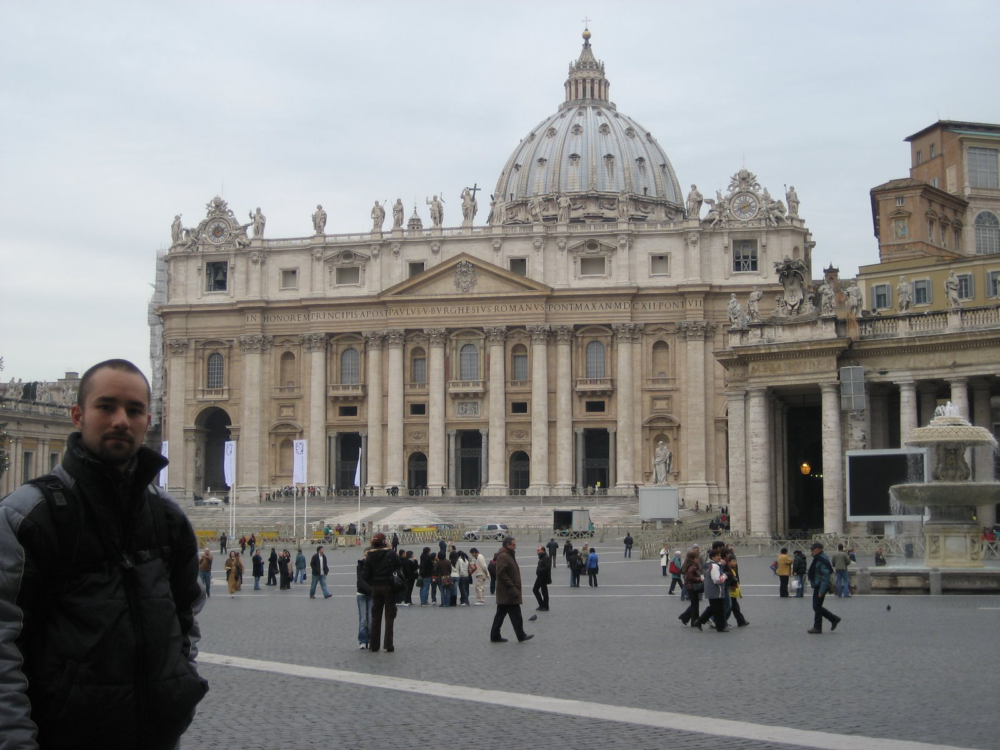

In [ ]:
for url in df_test.iloc[5:6]['url']:
  image = io.imread(url) 
  image_2 = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
  cv2_imshow(image_2)
  print('\n')

## Face recognition

In [ ]:
df_test

,id,url,landmark_id
0,e86c3c992591d147,https://lh5.googleusercontent.com/-7AoJnw2esWw...,9633
1,ecd857884464154d,https://lh6.googleusercontent.com/-xAmqD_PLM28...,9633
2,6c1b01259ae87ddc,https://lh6.googleusercontent.com/-QCDV0ENYxPI...,9633
3,f92fa6b19b56aa0a,https://lh3.googleusercontent.com/-oYFvHLf8HEQ...,9633
4,9c5f1cea9834d581,https://lh5.googleusercontent.com/-Q15GMLfJpdc...,9633
...,...,...,...
495,5954bc8e873025a9,http://lh6.ggpht.com/-V8Zporo194I/TI-8X9XT5iI/...,4352
496,07ae948ad261aa27,https://lh4.googleusercontent.com/-L5PP2NxUNBw...,4352
497,52558193f89e4106,https://lh3.googleusercontent.com/-3c0tcIpfSBE...,4352
498,370cb91387ef8c72,https://lh4.googleusercontent.com/-K7_WSxyUF4A...,4352


**IMPORTANTE:**
Para ejecutar el siguiente bloque de código,  son necesarios dos archivos que fueron entregados junto con este notebook (deploy.prototxt.txt y face_detection_cm.caffemodel), deben ubicarse en la misma ruta que se encuentre el notebook o en alguna otra y modificar las primeras dos lineas con la ubicación.

Carga del modelo

In [ ]:
prototextPath = './deploy.prototxt.txt'
caffeModelPath = './face_detection_cm.caffemodel'

net = cv2.dnn.readNetFromCaffe(prototextPath, caffeModelPath)

Función para hacer detección de rostros

In [ ]:
def detectFaces(image):
  image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

  # extract the dimensions , Resize image into 300x300 and converting image into blobFromImage
  (h,w) = image.shape[:2]
  # blobImage convert RGB (104.0, 177.0, 123.0)
  blob = cv2.dnn.blobFromImage(cv2.resize(image,(300,300)),1.0,(300,300),(104.0, 177.0, 123.0))

  #passing blob through the network to detect and prediction
  net.setInput(blob)
  detections = net.forward()

  # loop over the detections
  for i in range(0, detections.shape[2]):
      confidence = detections[0, 0, i, 2]

      # se filtran las detecciones en base a este parametro de confianza
      if confidence > 0.4:
          # coordinadas x,y para el bounding box
          box = detections[0, 0, i, 3:7] * np.array([w, h, w, h])
          (startX, startY, endX, endY) = box.astype("int")

          # draw the bounding box of the face along Confidance
          # probability
          text = "{:.2f}%".format(confidence * 100)
          y = startY - 10 if startY - 10 > 10 else startY + 10
          cv2.rectangle(image, (startX, startY), (endX, endY),
                        (0, 0, 255), 2)
          cv2.putText(image, text, (startX, y),
                      cv2.FONT_HERSHEY_SIMPLEX, 0.45, (0, 0, 255), 2)

          cv2_imshow(image)
          cv2.waitKey(0)

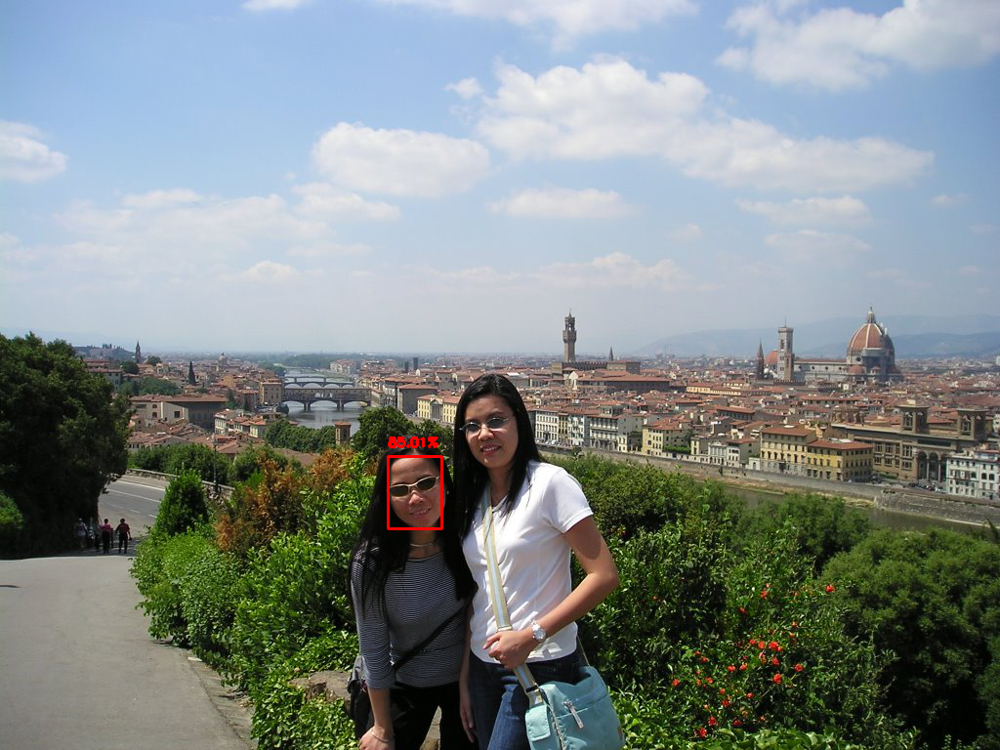

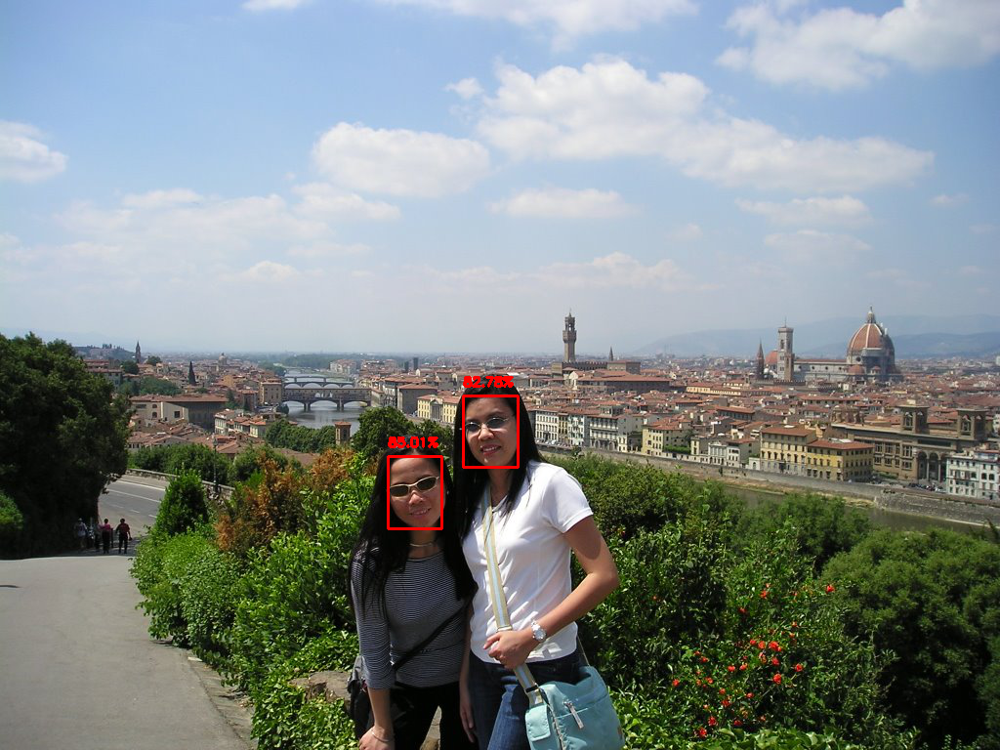

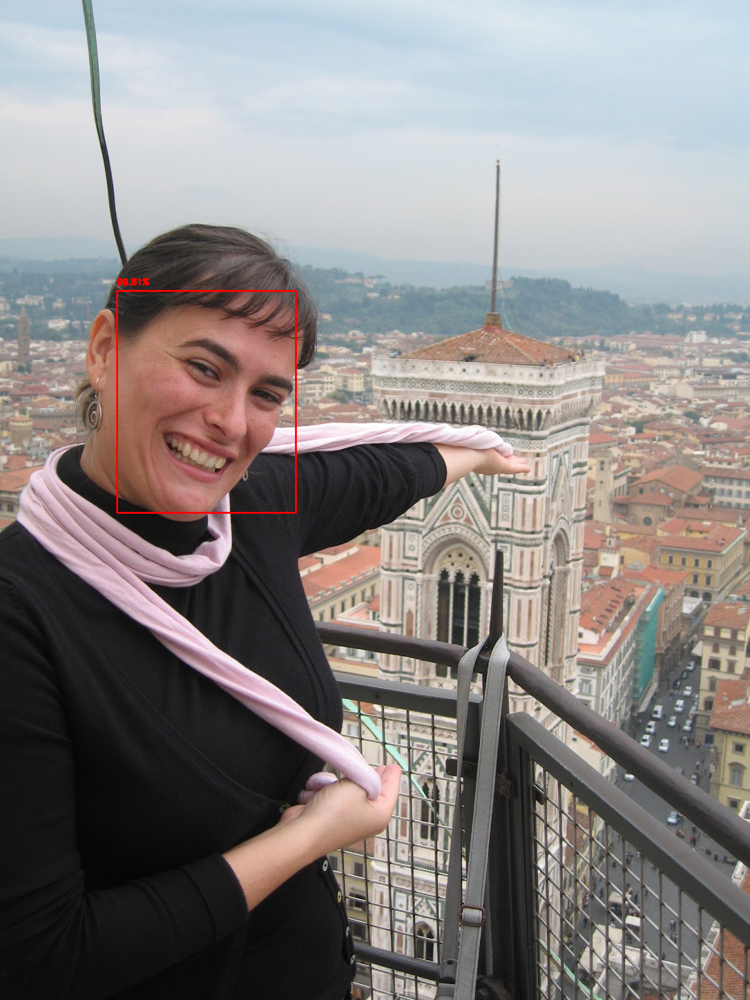

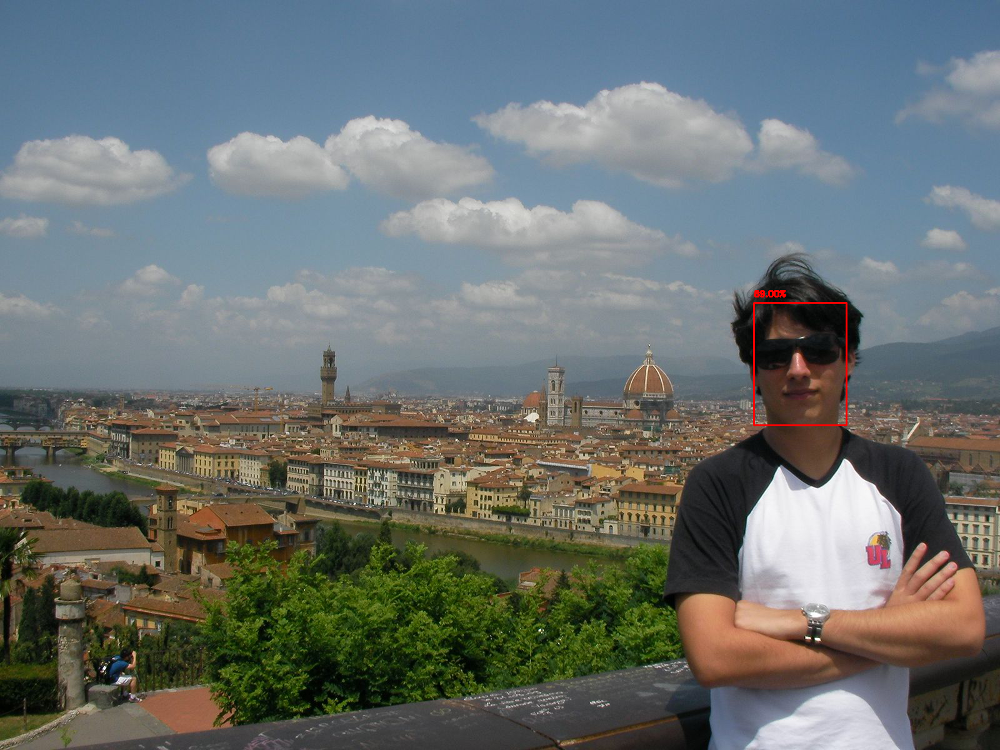

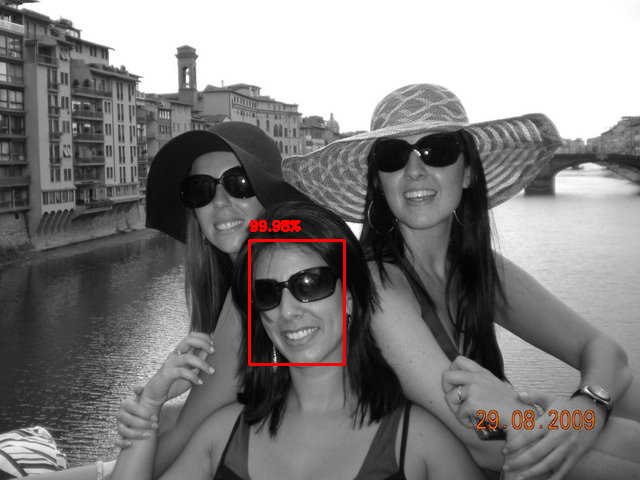

...

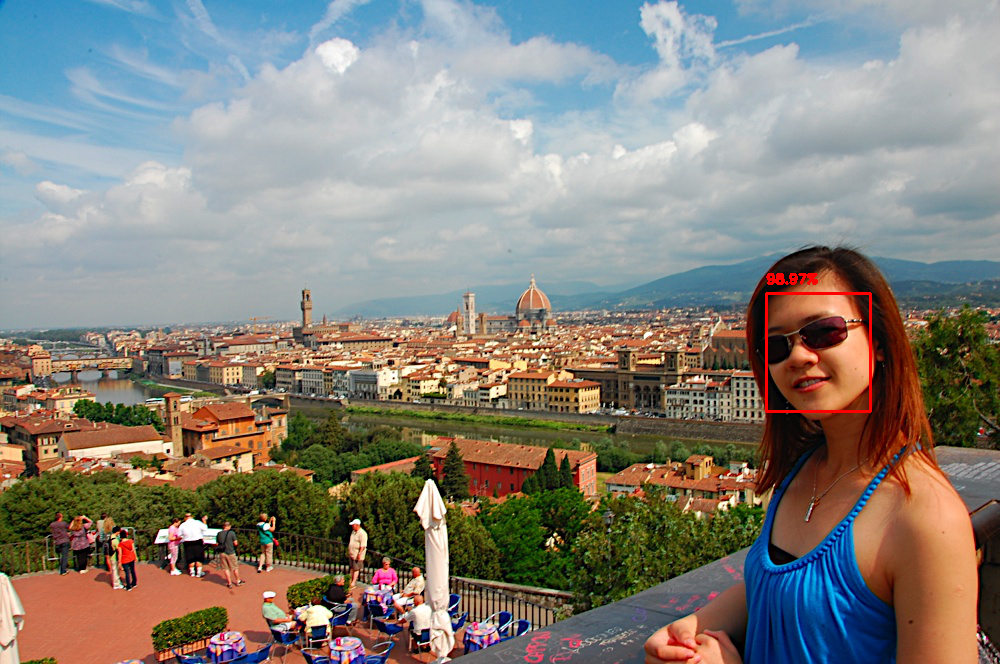

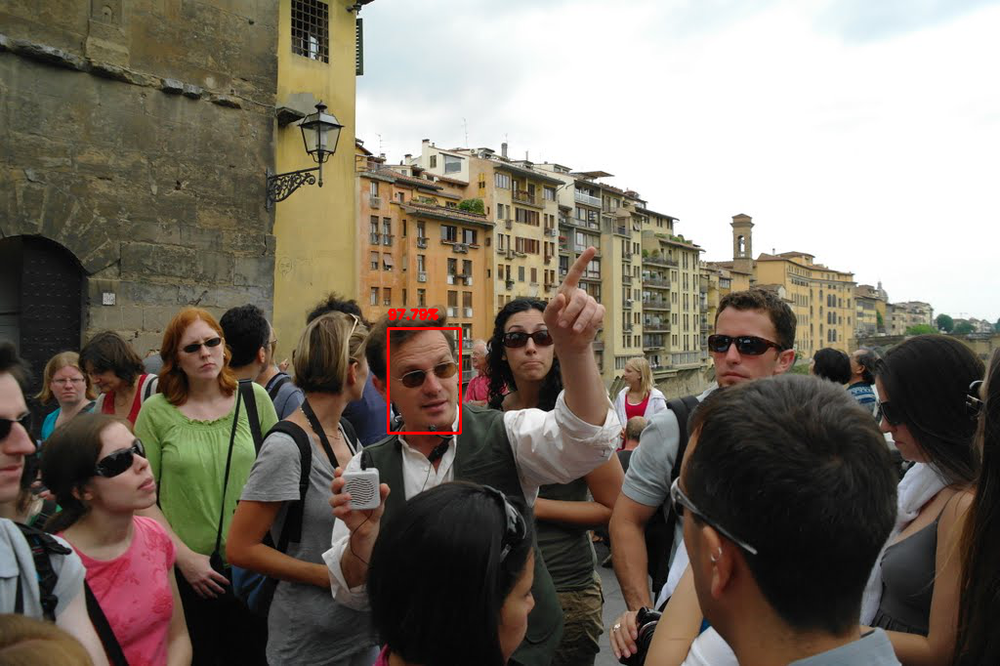

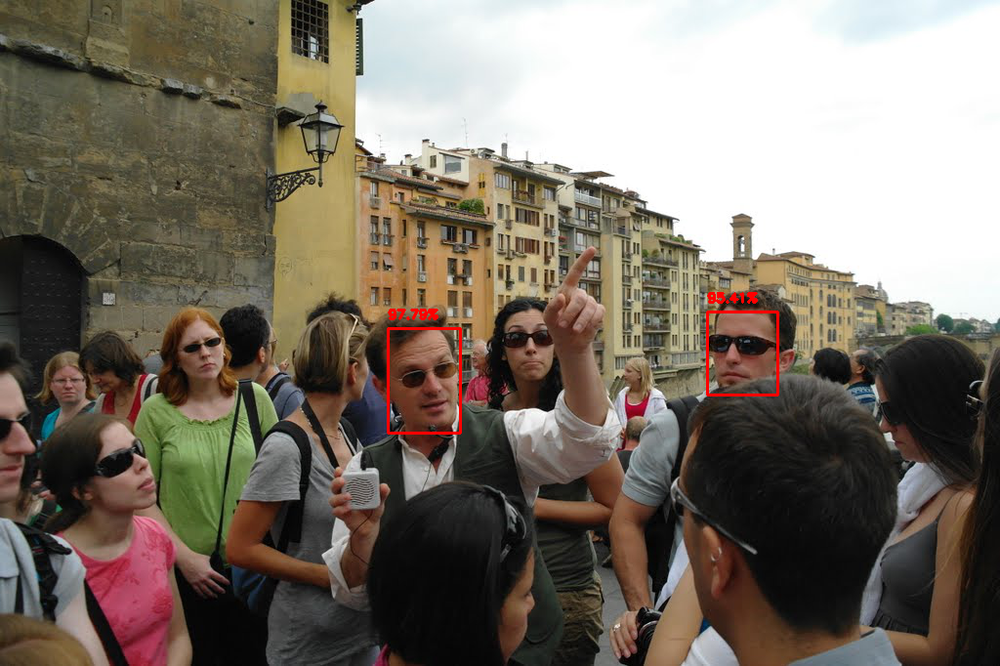

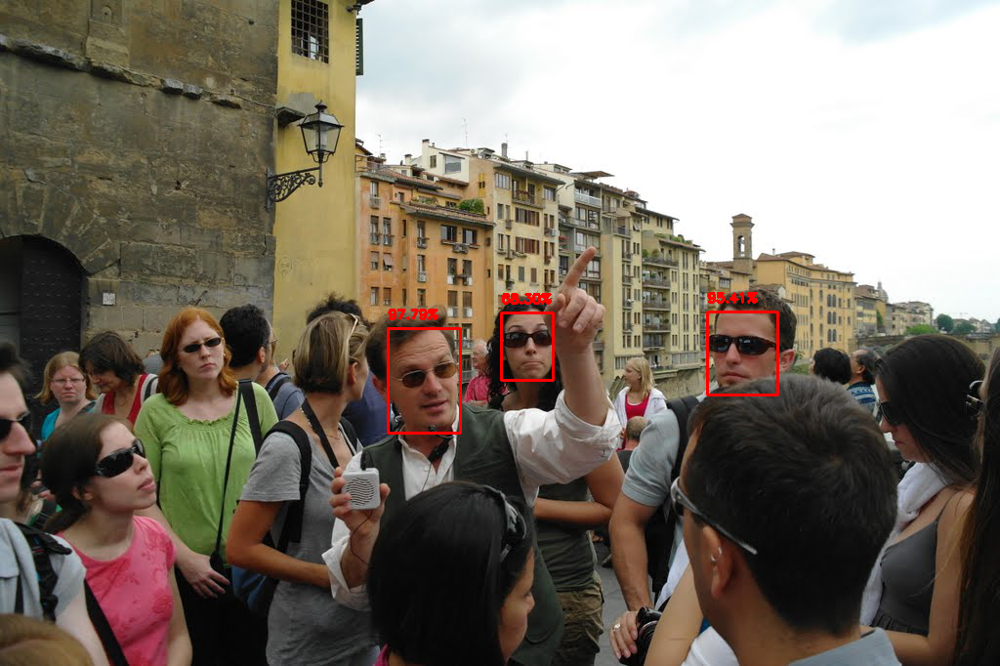

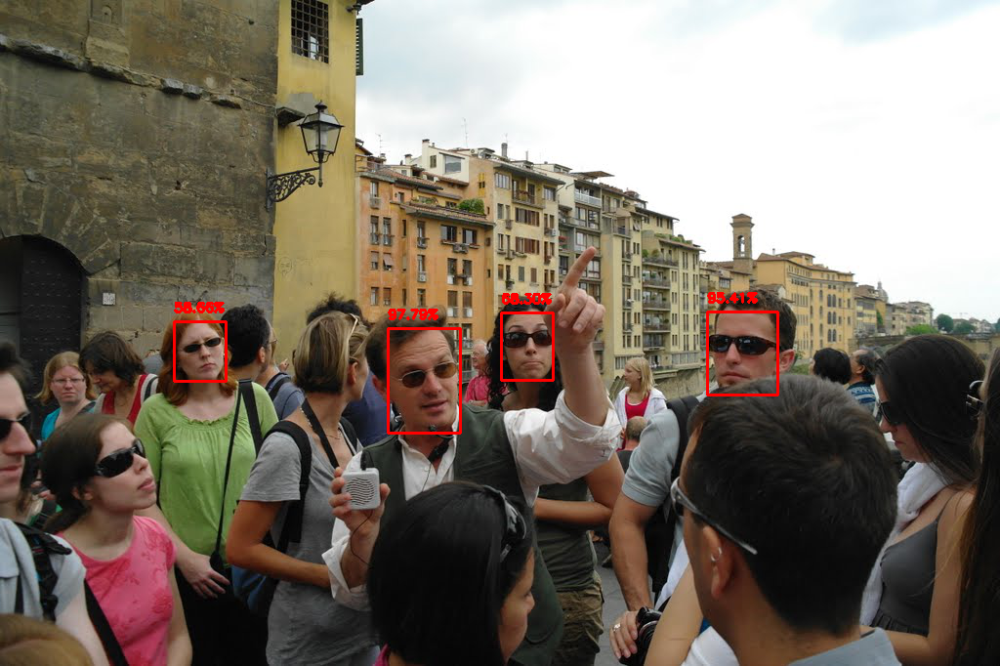

In [ ]:
for image in X[305:320]:
  detectFaces(image)

Función para anonimizar rostros

In [ ]:
def anonymize_face_simple(image, factor=3.0):
	# automatically determine the size of the blurring kernel based
	# on the spatial dimensions of the input image
	(h, w) = image.shape[:2]
	kW = int(w / factor)
	kH = int(h / factor)
	# ensure the width of the kernel is odd
	if kW % 2 == 0:
		kW -= 1
	# ensure the height of the kernel is odd
	if kH % 2 == 0:
		kH -= 1
	# apply a Gaussian blur to the input image using our computed
	# kernel size
	return cv2.GaussianBlur(image, (kW, kH), 0)

In [ ]:
def anonymize_face_pixelate(image, blocks=3):
	# divide the input image into NxN blocks
	(h, w) = image.shape[:2]
	xSteps = np.linspace(0, w, blocks + 1, dtype="int")
	ySteps = np.linspace(0, h, blocks + 1, dtype="int")
	# loop over the blocks in both the x and y direction
	for i in range(1, len(ySteps)):
		for j in range(1, len(xSteps)):
			# compute the starting and ending (x, y)-coordinates
			# for the current block
			startX = xSteps[j - 1]
			startY = ySteps[i - 1]
			endX = xSteps[j]
			endY = ySteps[i]
			# extract the ROI using NumPy array slicing, compute the
			# mean of the ROI, and then draw a rectangle with the
			# mean RGB values over the ROI in the original image
			roi = image[startY:endY, startX:endX]
			(B, G, R) = [int(x) for x in cv2.mean(roi)[:3]]
			cv2.rectangle(image, (startX, startY), (endX, endY),
				(B, G, R), -1)
	# return the pixelated blurred image
	return image

In [ ]:
def detectAndBlur(image, blur_method = 'simple'):
  image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
  orig = image.copy()

  # extract the dimensions , Resize image into 300x300 and converting image into blobFromImage
  (h,w) = image.shape[:2]
  # blobImage convert RGB (104.0, 177.0, 123.0)
  blob = cv2.dnn.blobFromImage(cv2.resize(image,(300,300)),1.0,(300,300),(104.0, 177.0, 123.0))

  #passing blob through the network to detect and prediction
  net.setInput(blob)
  detections = net.forward()

  # loop over the detections
  for i in range(0, detections.shape[2]):
      # extract the confidence and prediction
      confidence = detections[0, 0, i, 2]

      # filter detections by confidence greater than the minimum     #confidence
      # print(confidence)
      if confidence > 0.5:
          # compute the (x, y)-coordinates of the bounding box for the
          # object
          box = detections[0, 0, i, 3:7] * np.array([w, h, w, h])
          (startX, startY, endX, endY) = box.astype("int")

          # extract the face ROI
          face = image[startY:endY, startX:endX]

          # check to see if we are applying the "simple" face blurring
          # method
          if blur_method == "simple":
            face = anonymize_face_simple(face, factor=3.0)
          # otherwise, we must be applying the "pixelated" face
          # anonymization method
          else:
            face = anonymize_face_pixelate(face, 3)
          # store the blurred face in the output image
          image[startY:endY, startX:endX] = face

          output = np.hstack([orig, image])
          cv2_imshow(output)
          cv2.waitKey(0)

Método uno de anonimización

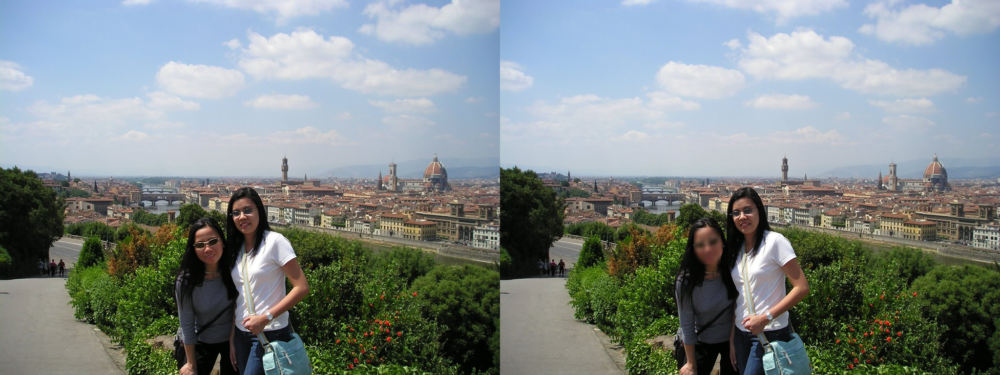

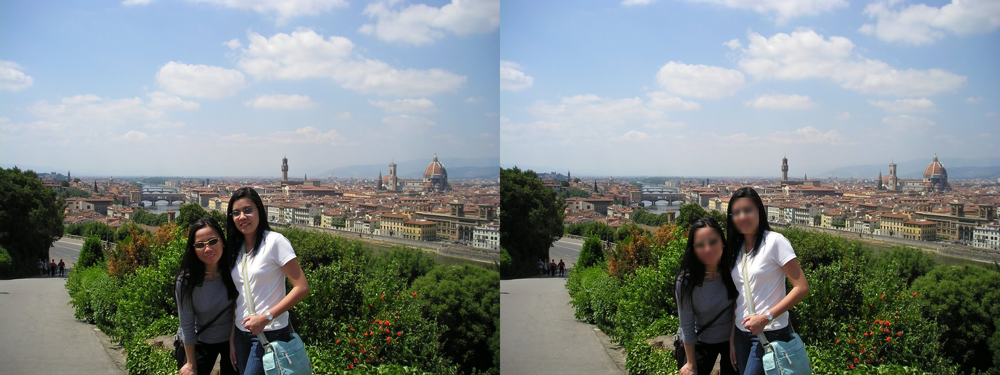

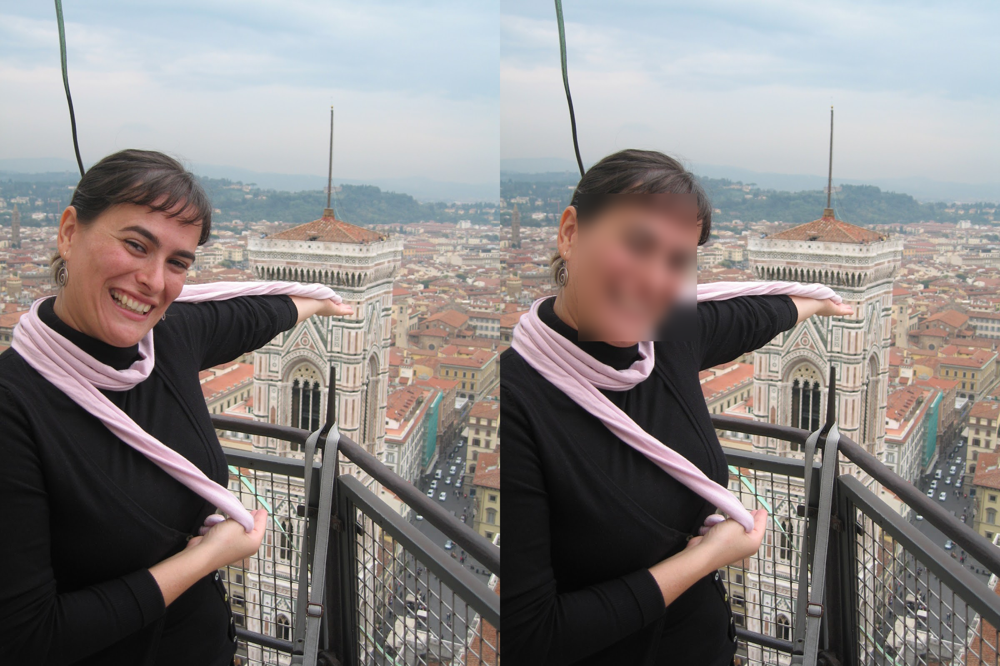

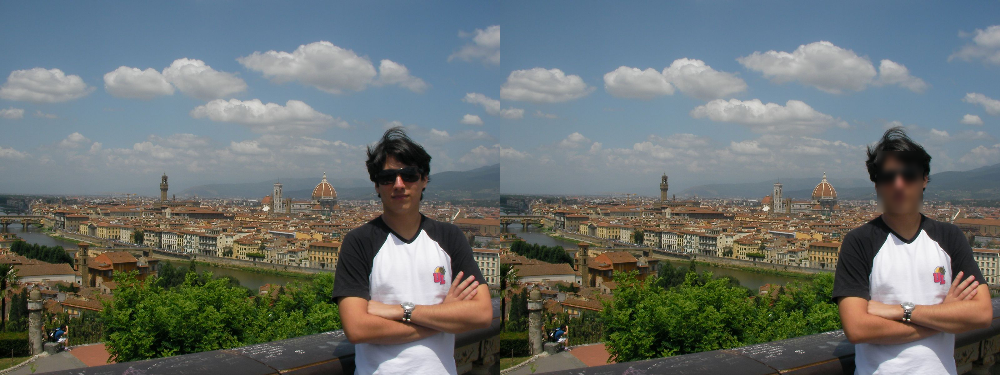

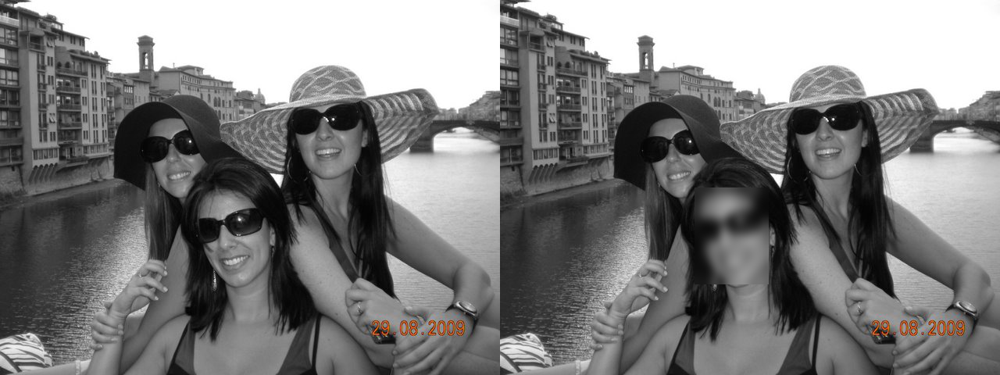

...

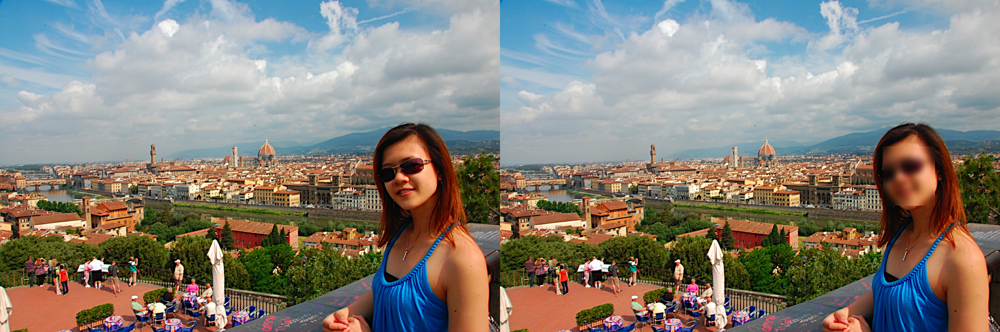

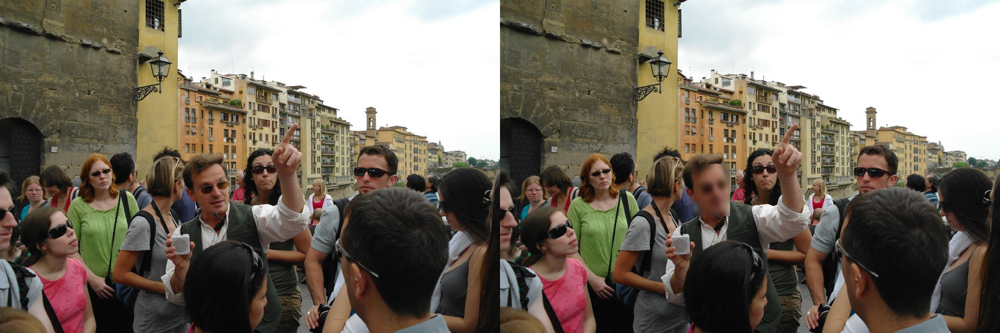

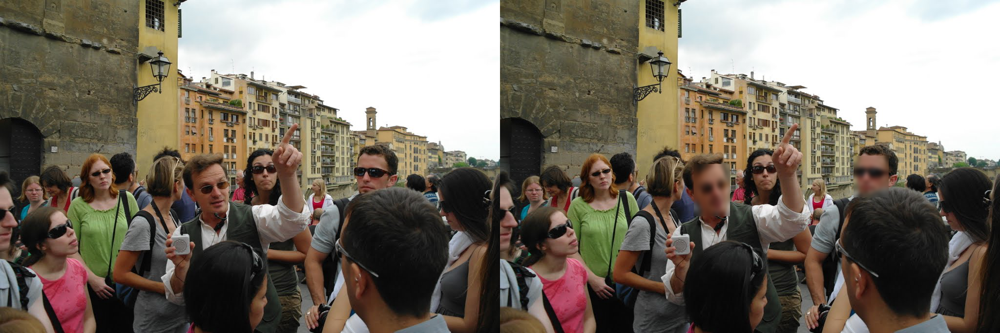

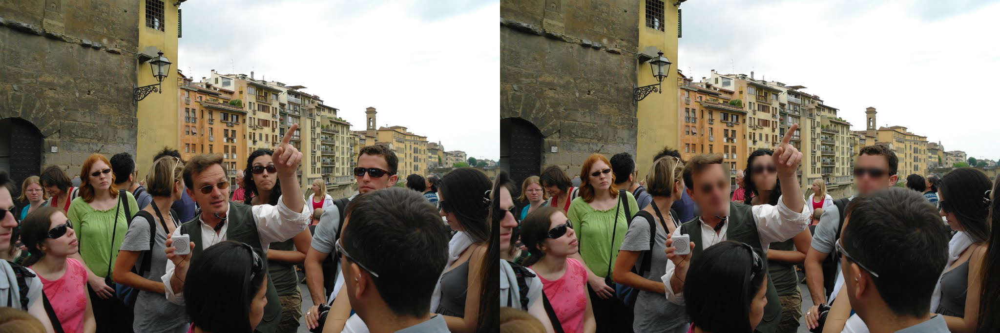

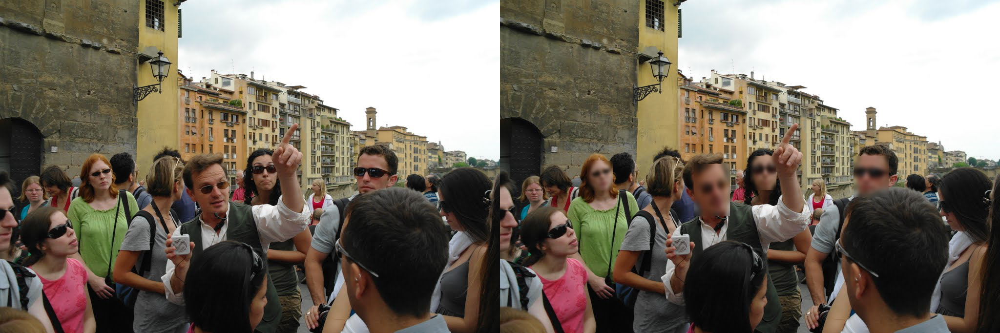

In [ ]:
for image in X[305:320]:
  detectAndBlur(image, 'simple')

Método dos de anonimización

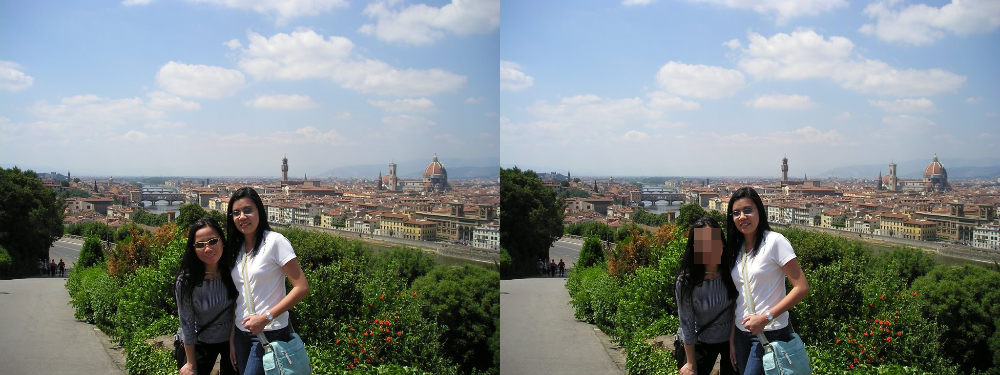

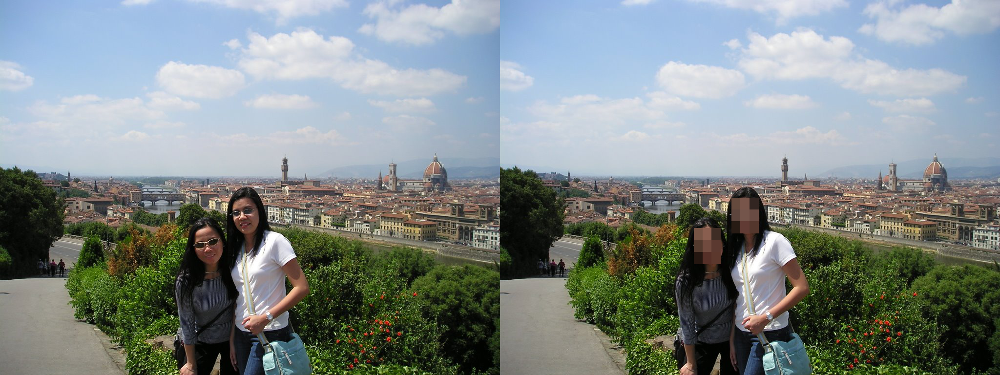

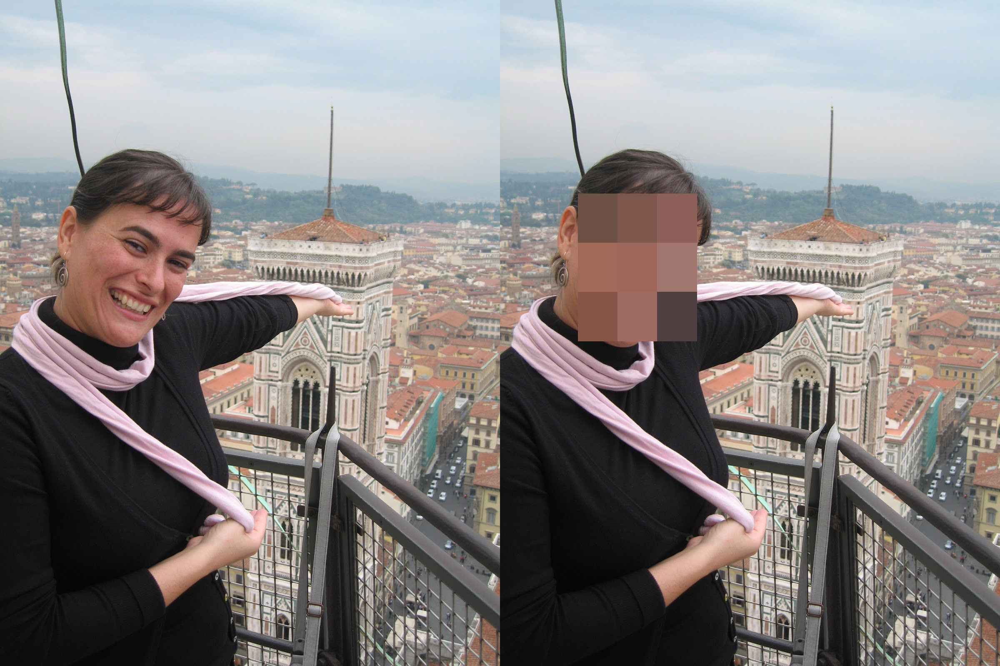

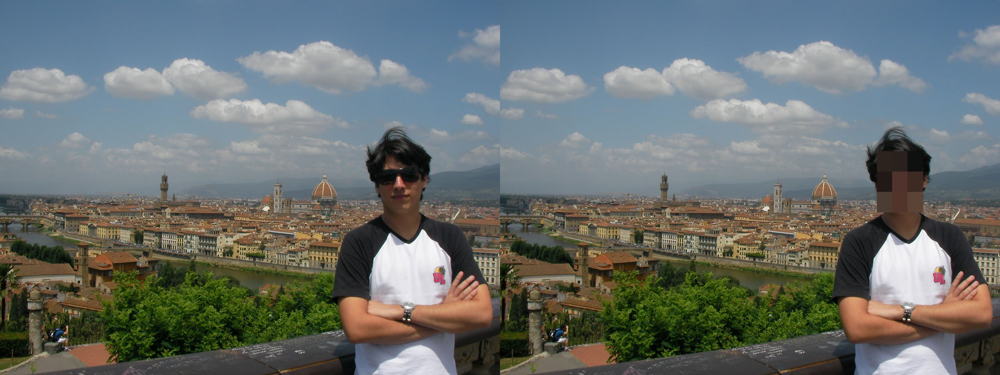

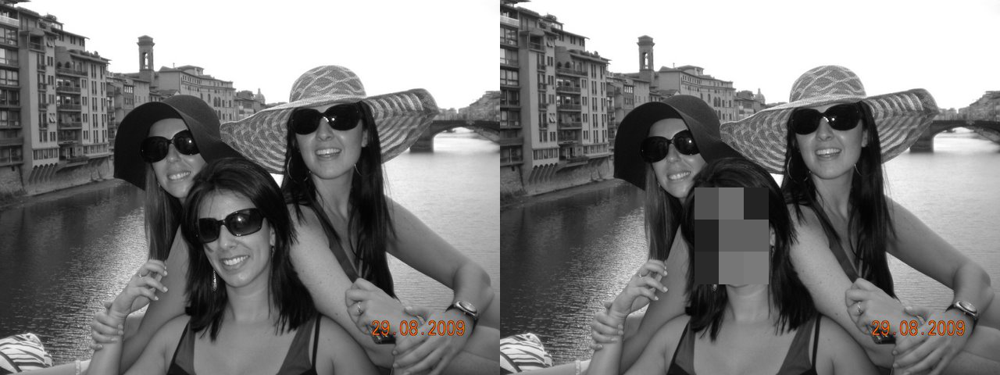

...

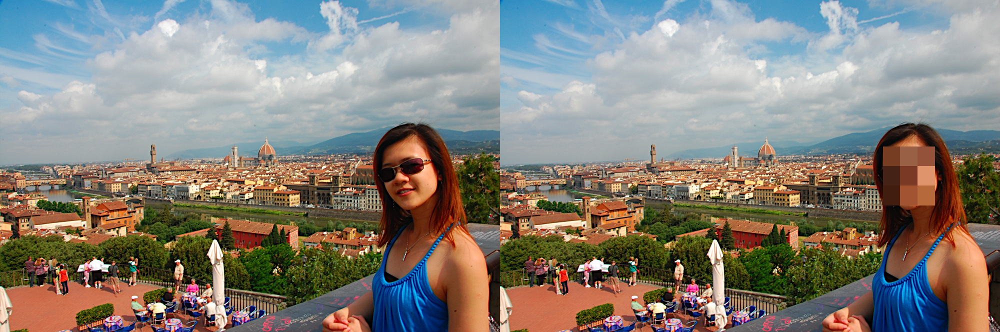

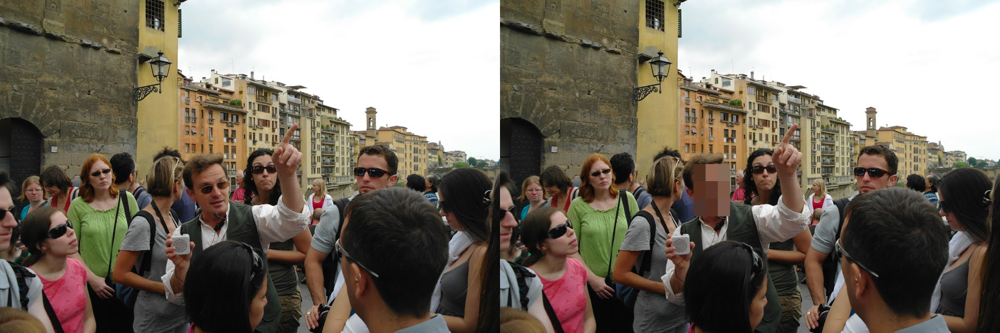

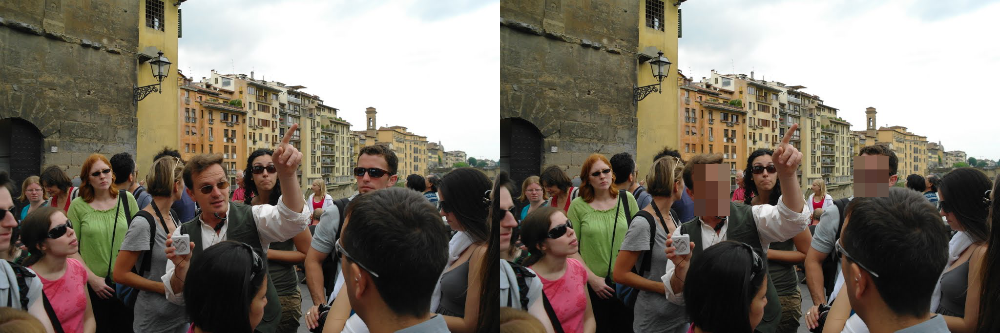

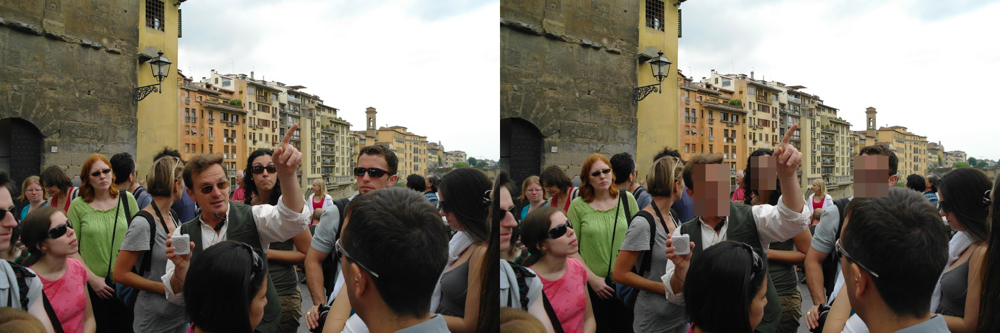

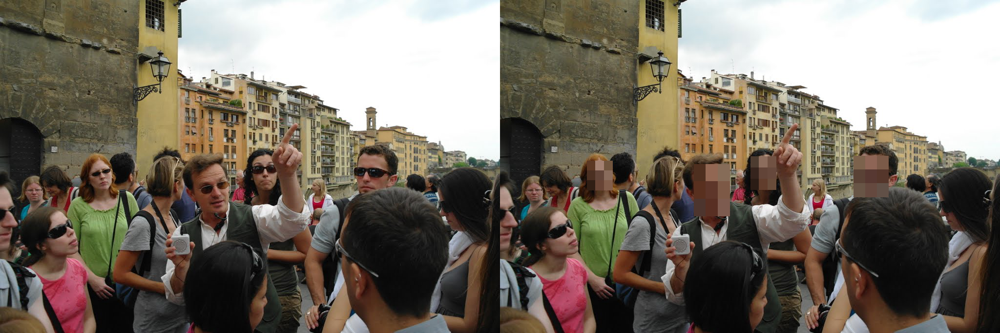

In [ ]:
for image in X[305:320]:
  detectAndBlur(image, 'pixelate')